## Discentes:
INF0417 - 202010396 - Francieli Moreira de Carvalho

INF0417 - 202005506 - Victor Guerreiro Pimenta

INF0417 - 202005493 - Letícia de Cerqueira Xavier

INF0417 - 202008062 - Jamil  Soares da Silva Júnior






#Atividade 1

## Exercício teórico simples (P)
Explique como funciona a detecção dos cantos de harris:

É um algoritmo que detecta cantos ou mudanças bruscas da imagem, é realizado pelos seguintes passos:

1- pré-processamento da imagem(filtro cinza e suavizaçao da imagem)

2- calculo de gradientes verticais e horizontais

3 - caculo da matriz de covariancia para cada pixel, para detectar mudança de
intensidade.

4 - Cálculo da resposta de harris(R = det(M) - k * trace(M)^2), para cada matriz

5 - Limiarização: para detectar pontos de maior interesse. Supressão: para eliminar respostas redundantes

6 - Marcaçao dos pontos na imagem original.

Desvantagens: mal funcioonamento com variaçoes de escala e rotaçao

## Exercício teórico mediano (M)
Explique a invariância a escala do metodo SIFT:

1 - Detecção de keypoints, tanto na imagem original quanto em imagens em outras escalas, atravás da aplicaçao do LoG.

1.1 - É feita uma piramide de imagens atraves do DoG, e um pixel é comparado com seus 8 vizinhos, e com 9 pixels acima e abaixo, se for um maximo local, ele é um potencial keypoint.

2 - Obtenção de uma resposta(x,y,z), em que x e y sao coordenadas do ponto e z a escala da imagem.



## Exercício teórico complexo (G)
Explique a invariância a rotação do metodo SIFT:

1- Cálculo dos keypoints em diferentes escalas

2 - A invariância a rotação é feita pelo HoG(histograma de gradientes orientados), que consite num histograma a partir da orientaçao dos vizinhos do keypoint.

3 - É calculada uma orientaçao dominate que é usada para orientar os descritores relacionados ao keypoint

4 uma vez calculada orientação para cada kpt, é calculado os descritores sift para cada sub-regiões ao redor desses pontos, esses coletam informações como cor e textura da região e são orientados para uma direção comum.

#Atividade 2

Implementar um programa de rastreamento de objetos que utiliza detecção de movimento em um vídeo. A solução deve ser capaz de identificar e rastrear objetos em movimento ao longo do vídeo, destacando-os com retângulos ou algum indicador visual.

Resposta:

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

!gdown "https://drive.google.com/uc?id=19GthVHkFG5wTutTq-XP1ugGohyutJJdS"

Downloading...
From: https://drive.google.com/uc?id=19GthVHkFG5wTutTq-XP1ugGohyutJJdS
To: /content/videoteste.mp4
100% 1.79M/1.79M [00:00<00:00, 163MB/s]


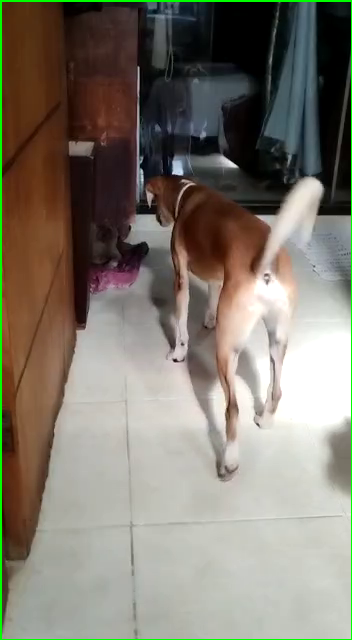

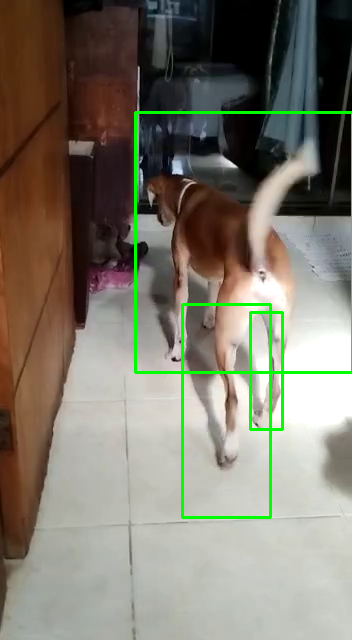

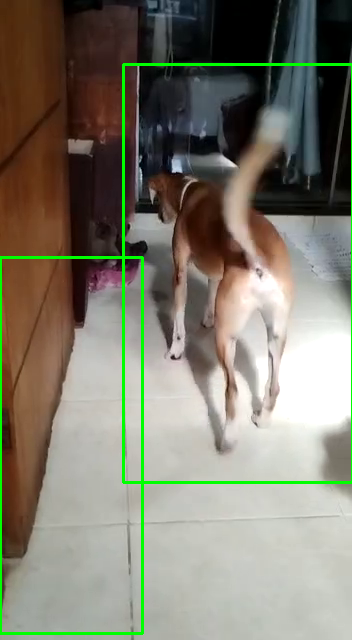

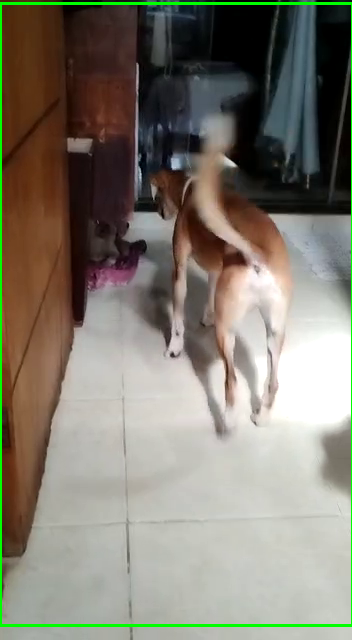

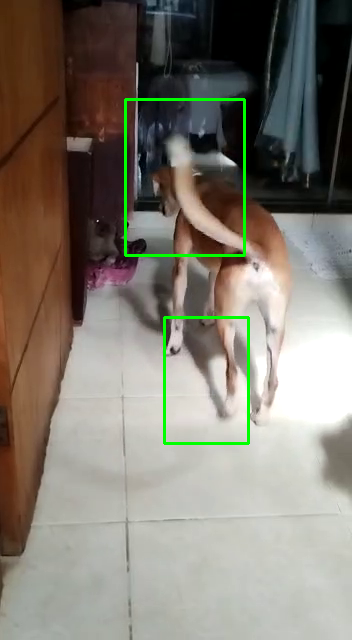

...

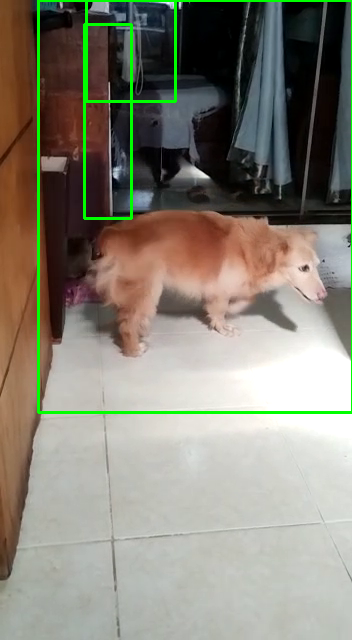

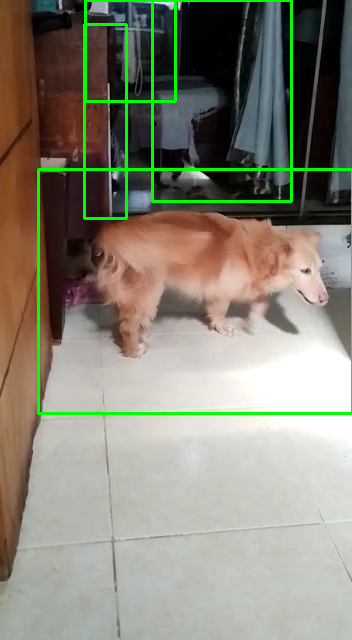

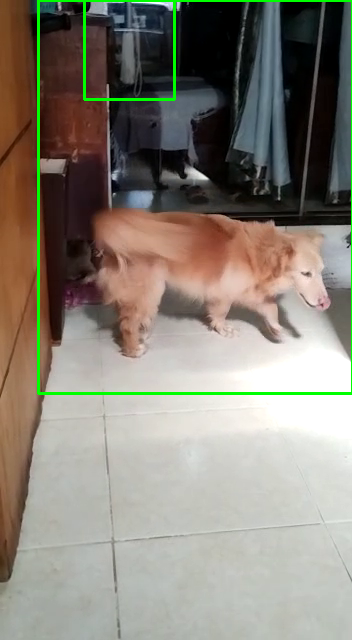

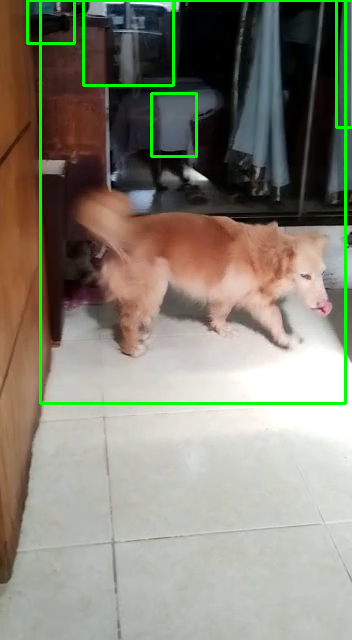

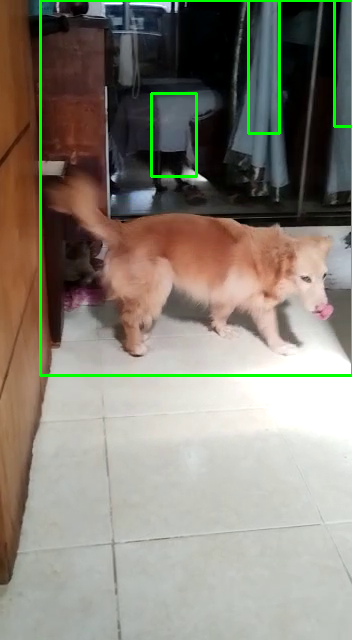

Buffered data was truncated after reaching the output size limit.

In [ ]:
# Carregar o vídeo
video = cv2.VideoCapture('/content/videoteste.mp4')

# Obter o primeiro frame
ret, frame = video.read()

# Inicializar o detector de movimento
fgbg = cv2.createBackgroundSubtractorMOG2()

while True:
    # Ler o próximo frame
    ret, frame = video.read()

    if not ret:
        break

    # Aplicar detecção de movimento em relação ao frame anterior
    fgmask = fgbg.apply(frame)

    # Encontrar contornos dos objetos em movimento
    contours, hierarchy = cv2.findContours(fgmask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    for contour in contours:
        # Definir critérios para identificar objetos de interesse
        if cv2.contourArea(contour) > 1000:
            # Rastrear e destacar objetos com retângulos
            x, y, w, h = cv2.boundingRect(contour)
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Mostrar o frame resultante
    cv2_imshow(frame)

    # Parar a execução ao pressionar a tecla 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Liberar os recursos
video.release()
